In [0]:
import numpy as np
import tensorflow  as tf
from tensorflow.examples.tutorials.mnist import input_data
from tensorflow.contrib.layers import fully_connected
import matplotlib.pyplot as plt
from matplotlib import cm
import pandas as pd
import librosa
from google.colab import files

In [2]:
files.upload()

Saving test_x_01.wav to test_x_01 (1).wav
Saving test_x_02.wav to test_x_02 (1).wav
Saving train_clean_male.wav to train_clean_male (1).wav
Saving train_dirty_male.wav to train_dirty_male (1).wav


{'test_x_01.wav': b'RIFF|7\x02\x00WAVEfmt \x12\x00\x00\x00\x01\x00\x01\x00\x80>\x00\x00\x00}\x00\x00\x02\x00\x10\x00\x00\x00dataV7\x02\x00\x16\x00\xf5\xff\xf1\xff\x07\x00\xc2\xff\n\x00\xf3\xff \x00\xea\xff\xe2\xff\xd1\xff\xee\xff\xe6\xff\xfa\xff\xc2\xff\xe6\xff\xd7\xff\xfa\xff\xf4\xff\xdd\xff\xee\xff\x00\x00\xc5\xff\x17\x00\xce\xff\xfb\xff\xe9\xff\xe4\xff\t\x00\x10\x00\xef\xff\xec\xff\x1b\x00\x1b\x00\x1f\x00\x0c\x00\xf1\xff\xed\xff\xff\xff\x19\x00\n\x00\'\x007\x00\xda\xff#\x00\x0b\x00\x0e\x00\xf9\xff\xe5\xff\xf2\xff\xcd\xff\xdb\xff\xf7\xff\xae\xff\n\x00H\xff\'\x00\xc4\xff+\x00\x14\x00\x9a\xffl\x00\xea\xffe\x00\x14\x00\xb4\xff,\x00\xf9\xffN\x00\x12\x00\x17\x00\xf9\xff\x0e\x00\x1b\x00X\x00\x14\x00Q\x00\x10\x00&\x00\x10\x00\x18\x00C\x00C\x00\xf7\xff\xe9\xff\t\x00$\x00&\x00\xdd\xff\xe4\xff8\x00-\x00*\x00!\x00\xe7\xff\xce\xff\xdd\xff\x13\x00\x15\x00\xd9\xff\x00\x00\xd4\xffC\x00\x16\x00F\x00\xfe\xff\xd8\xff"\x00[\x00`\x00\x16\x00A\x00\x17\x00J\x00\x1b\x00G\x00\xa8\x00\xb7\xff\xb5\x00\xb7\xff

In [0]:
X = tf.placeholder(tf.float32, shape=(None,513))
y = tf.placeholder(tf.float32, shape=(None,513))

In [0]:
#Loading train files
s, sr=librosa.load('train_clean_male.wav', sr=None)
S=librosa.stft(s, n_fft=1024, hop_length=512)
sn, sr=librosa.load('train_dirty_male.wav', sr=None) 
Xs=librosa.stft(sn, n_fft=1024, hop_length=512)

In [0]:
#Loading test files
test1, sr1 = librosa.load('test_x_01.wav', sr=None)
t1 = librosa.stft(test1, n_fft=1024, hop_length=512)
test2, sr2 = librosa.load('test_x_02.wav', sr=None)
t2 = librosa.stft(test2, n_fft=1024, hop_length=512)

In [0]:
#Taking absolute of input and output of training file
Xs_abs =  np.abs(Xs).T
S_abs = np.abs(S).T

In [7]:
print(Xs_abs.shape)
print(S_abs.shape)

(2459, 513)
(2459, 513)


In [0]:
#Taking absolute of input and output of test file
t1_abs = np.abs(t1).T
t2_abs = np.abs(t2).T

In [9]:
print(t1_abs.shape)
print(t2_abs.shape)

(142, 513)
(380, 513)


In [0]:
x_image = tf.reshape(X, [-1,513,1])

In [11]:
#Convolution layer 1
cl1 = tf.layers.conv1d(x_image, filters=32, kernel_size=2, strides=1, padding="same")
cl1 = tf.nn.relu(cl1)

#Convolution layer 2
cl2 = tf.layers.conv1d(cl1, filters=64, kernel_size=2, strides=1, padding="same")
cl2 = tf.nn.relu(cl2)

#Maxpool layer 1
mp1 = tf.layers.max_pooling1d(cl2, pool_size=3, strides=2, padding="same")

#Convolution layer 3
cl3 = tf.layers.conv1d(mp1, filters=128, kernel_size=2, strides=1, padding="same")
cl3 = tf.nn.relu(cl3)

#Maxpool layer 1
mp2 = tf.layers.max_pooling1d(cl3, pool_size=3, strides=2, padding="same")

num_features = mp2.get_shape()[1:4].num_elements()
dense_layer = tf.reshape(mp2, [-1,num_features])

#Dense layer 1
dl1 = fully_connected(dense_layer,512)

#Dropout layer 1
drl1 = tf.layers.dropout(dl1, rate=0.2, seed=123)

#Output layer
reg_op = fully_connected(drl1, 513)

Instructions for updating:
Use keras.layers.conv1d instead.
Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Use keras.layers.max_pooling1d instead.
Instructions for updating:
Use keras.layers.dropout instead.


In [12]:
#Mean Square Error(MSE) - Defining the error calculated using output of the NN and the given output
mse = tf.losses.mean_squared_error(labels=y, predictions=reg_op)
loss = tf.reduce_mean(mse, name="loss")

#Calculation of Rsquared, which is a measure of error for a regression problem
total_error = tf.reduce_sum(tf.square(tf.subtract(y, tf.reduce_mean(y))))
unexplained_error = tf.reduce_sum(tf.square(tf.subtract(y, reg_op)))
R_squared = tf.subtract(1.0, tf.div(unexplained_error, total_error))

Instructions for updating:
Use tf.cast instead.
Instructions for updating:
Deprecated in favor of operator or tf.math.divide.


In [0]:
lr = 0.0001

#Using Adam Optimizer for minimizing the loss
optimizer2 = tf.train.AdamOptimizer(lr).minimize(loss)

In [0]:
init = tf.global_variables_initializer()
saver = tf.train.Saver()

In [15]:
#Training the NN
n_epochs = 1000
batch_size = 128
accuracies = []

with tf.Session() as sess:
  init.run()
  for epoch in range(n_epochs):
    for iteration in range(Xs_abs.shape[0] // batch_size):
      X_batch = Xs_abs[batch_size*iteration:batch_size*(iteration+1)]
      y_batch = S_abs[batch_size*iteration:batch_size*(iteration+1)]
      sess.run(optimizer2, feed_dict = {X: X_batch, y: y_batch})
    acc_train = R_squared.eval(feed_dict={X: X_batch, y: y_batch})
    accuracies.append(acc_train*100)
    #acc_test = R_squared.eval(feed_dict={X2: mnist.test.images, y2:mnist.test.labels})
    if epoch % 100 == 0:
      print('Epoch:', epoch, "Train accuracy:", acc_train)
    #, "Test accuracy:", acc_test
    
  save_path = saver.save(sess, "./audio_model.ckpt")

Epoch: 0 Train accuracy: 0.12195164
Epoch: 100 Train accuracy: 0.9177922
Epoch: 200 Train accuracy: 0.95030934
Epoch: 300 Train accuracy: 0.9521894
Epoch: 400 Train accuracy: 0.9683454
Epoch: 500 Train accuracy: 0.97463506
Epoch: 600 Train accuracy: 0.97032726
Epoch: 700 Train accuracy: 0.979962
Epoch: 800 Train accuracy: 0.98334044
Epoch: 900 Train accuracy: 0.9740618


Text(0.5, 1.0, '1D CNN')

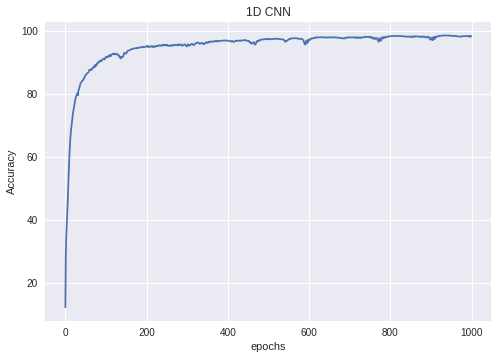

In [16]:
eps = np.arange(0,n_epochs)
plt.plot(eps, accuracies)
plt.xlabel('epochs')
plt.ylabel('Accuracy')
plt.title('1D CNN')

In [0]:
#Function to recover clean audio from input in  time domain after running through the trained NN
def speech_recovery(data):
  X1 = librosa.stft(data, n_fft=1024, hop_length=512)
  X_abs = np.abs(X1).T
  with tf.Session() as sess:
    saver.restore(sess, "./audio_model.ckpt")
    clean = reg_op.eval(feed_dict = {X: X_abs})
        
    #Hadamard product to construct clean test signal
    sabs = tf.multiply(tf.div(X1,np.abs(X1)),clean.T)
    
    sbar = sabs.eval(feed_dict={X: X_abs})
    
    #inverse stft to bring the signal to time domain
    s = librosa.core.istft(sbar, hop_length=512, length=len(data))
    
    return s  

In [18]:
#Recovering the vector for clean audio of test1 after running through the NN
test1_clean = speech_recovery(test1)

Instructions for updating:
Use standard file APIs to check for files with this prefix.
INFO:tensorflow:Restoring parameters from ./audio_model.ckpt


In [0]:
librosa.output.write_wav('test_s_01_1d_cnn_recons.wav', test1_clean, sr1)

In [0]:
files.download('test_s_01_1d_cnn_recons.wav')

In [21]:
#Recovering the vector for clean audio of test2
test2_clean = speech_recovery(test2)

INFO:tensorflow:Restoring parameters from ./audio_model.ckpt


In [0]:
librosa.output.write_wav('test_s_02_1d_cnn_recons.wav', test2_clean, sr2)
files.download('test_s_02_1d_cnn_recons.wav')

In [23]:
train_clean = speech_recovery(sn)

INFO:tensorflow:Restoring parameters from ./audio_model.ckpt


In [24]:
#SNR - Signal to Noise Ratio for input file
num = np.sum(np.square(train_clean))
den = np.sum(np.square(np.subtract(s, train_clean)))
snr = 10*np.log10(num/den)
print('Signal to Noise Ratio for input file:',snr)

Signal to Noise Ratio for input file: 17.97378182411194


### Problem 2

In [0]:
ip_images = list()
for t in range(0,Xs_abs.shape[0]-19):
  ip = Xs_abs[t:t+20,:]
  #print(ip.shape)
  ip_images.append(ip)
ip_images = np.array(ip_images)

In [0]:
op_images = S_abs[19:]

In [27]:
print(ip_images.shape)
print(op_images.shape)

(2440, 20, 513)
(2440, 513)


In [0]:
X2 = tf.placeholder(tf.float32, shape=(None,20,513))
x_image_2d = tf.reshape(X2, [-1,20,513,1])

In [29]:
#2D Convolutional Layer 1
conv_2d_layer_1 = tf.layers.conv2d(x_image_2d, filters=32, kernel_size=4, strides=(1,1), padding="same")
conv_2d_layer_1 = tf.nn.relu(conv_2d_layer_1)

#2D Maxpooling layer
mp_2d_1 = tf.layers.max_pooling2d(conv_2d_layer_1, pool_size=[2,2], strides=[2,2], padding="same")

#2D Convolutional Layer 2
conv_2d_layer_2 = tf.layers.conv2d(mp_2d_1, filters=64, kernel_size=2, strides=(1,1), padding="same")
conv_2d_layer_2 = tf.nn.relu(conv_2d_layer_2)

#2D Maxpooling layer
mp_2d_2 = tf.layers.max_pooling2d(conv_2d_layer_2, pool_size=[2,2], strides=[2,2], padding="same")

num_features_2d = mp_2d_2.get_shape()[1:4].num_elements()
dense_layer_2d = tf.reshape(mp_2d_2, [-1,num_features_2d])

#Fully Connected Layer
dl_2d_1 = fully_connected(dense_layer_2d, 4048)

#Dropout Layer 1
dr_2d_1 = tf.layers.dropout(dl_2d_1, rate=0.3)

#Output Layer
reg_op_2d = fully_connected(dr_2d_1, 513)


Instructions for updating:
Use keras.layers.conv2d instead.
Instructions for updating:
Use keras.layers.max_pooling2d instead.


In [0]:
#Mean Square Error(MSE) - Defining the error calculated using output of the NN and the given output
mse_2d = tf.losses.mean_squared_error(labels=y, predictions=reg_op_2d)
loss_2d = tf.reduce_mean(mse_2d, name="loss")

#Calculation of Rsquared, which is a measure of error for a regression problem
total_error = tf.reduce_sum(tf.square(tf.subtract(y, tf.reduce_mean(y))))
unexplained_error_2d = tf.reduce_sum(tf.square(tf.subtract(y, reg_op_2d)))
R_squared_2d = tf.subtract(1.0, tf.div(unexplained_error_2d, total_error))

In [0]:
#Using Adam Optimizer for minimizing the loss
lr = 0.0002
optimizer2 = tf.train.AdamOptimizer(lr).minimize(loss_2d)

In [0]:
init = tf.global_variables_initializer()
saver = tf.train.Saver()

In [0]:
#Training the NN
n_epochs = 1000
batch_size = 128
acc_2d = []

with tf.Session() as sess:
  init.run()
  for epoch in range(n_epochs):
    for iteration in range(len(ip_images) // batch_size):
      X_batch = ip_images[iteration*batch_size:(iteration+1)*batch_size]
      y_batch = op_images[iteration*batch_size:(iteration+1)*batch_size]
      sess.run(optimizer2, feed_dict = {X2: X_batch, y: y_batch})
    acc_train = R_squared_2d.eval(feed_dict={X2: X_batch, y: y_batch})
    acc_2d.append(acc_train*100)
    if epoch % 100 == 0:
      print(epoch, "Train accuracy:", acc_train)
    #, "Test accuracy:", acc_test
    
  save_path = saver.save(sess, "./audio_model_2d_cnn.ckpt")

0 Train accuracy: 0.11435819
100 Train accuracy: 0.9650008
200 Train accuracy: 0.97224635
300 Train accuracy: 0.97995853
400 Train accuracy: 0.98678005


In [0]:
eps = np.arange(0,n_epochs)
plt.plot(eps, acc_2d)
plt.xlabel('epochs')
plt.ylabel('Accuracy')
plt.title('2D CNN')

In [0]:
def speech_recovery_2d(data):
  X1 = librosa.stft(data, n_fft=1024, hop_length=512)
  X_abs = np.abs(X1).T
  
  #Clipping the input
  #X1 = X1[:,19:]
  #print(X1.shape)
  
  ip_test = list()
  for t in range(0,X_abs.shape[0]-19):
    ip = X_abs[t:t+20,:]
    ip_test.append(ip)
  ip_test = np.array(ip_test)
  
  with tf.Session() as sess:
    saver.restore(sess, "./audio_model_2d_cnn.ckpt")
    clean = reg_op_2d.eval(feed_dict = {X2: ip_test})
    
    #Padding clean output with small values
    rand_pad = np.random.rand(19,513)/100
    clean = np.concatenate((rand_pad,clean), axis=0)
    
        
    #Hadamard product to construct clean test signal
    sabs = tf.multiply(tf.div(X1,np.abs(X1)),clean.T)
    
    sbar = sabs.eval(feed_dict={X2: ip_test})
    
    #inverse stft to bring the signal to time domain
    s = librosa.core.istft(sbar, hop_length=512, length=len(data))
    
    return s  

In [0]:
test1_2d_clean = speech_recovery_2d(test1)

In [0]:
librosa.output.write_wav('test_s_01_2d_cnn_recons.wav', test1_2d_clean, sr1)
files.download('test_s_01_2d_cnn_recons.wav')

In [0]:
test2_2d_clean = speech_recovery_2d(test2)
librosa.output.write_wav('test_s_02_2d_cnn_recons.wav', test2_2d_clean, sr2)
files.download('test_s_02_2d_cnn_recons.wav')

In [0]:
train_clean_2d = speech_recovery_2d(sn)

In [0]:
#SNR - Signal to Noise Ratio for input file
num = np.sum(np.square(train_clean_2d))
den = np.sum(np.square(np.subtract(s, train_clean_2d)))
snr = 10*np.log10(num/den)
print('Signal to Noise Ratio for input file:',snr)